In [1]:
import os
import json
# from ./../Utils.data.preprocessing import load_rizhiyi_json_file_as_dataframe
from data.preprocessing import load_rizhiyi_json_file_as_dataframe
import pandas as pd
import numpy as np

In [2]:
root_dir = "./../../../data/riviyi_test"
filename = "o2_process_load_percent.json"
# filename = "o1.json"
# filename = "o2.json"

log_data:pd.DataFrame = load_rizhiyi_json_file_as_dataframe(root_dir, filename)

log_data.head()

,kpi_id,kpiName,time_interval_ms,endpoint,appname,service,name,anonymity,context_id,value,ts,timestamp
0,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,14.217,2020-09-30:23:59:00.000,1601481580000
1,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,14.110,2020-09-30:23:58:00.000,1601481520000
2,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,13.964,2020-09-30:23:57:00.000,1601481460000
3,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,13.219,2020-09-30:23:56:00.000,1601481400000
4,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,13.613,2020-09-30:23:55:00.000,1601481340000


In [3]:
log_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 127716 entries, 0 to 127715
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   kpi_id            127716 non-null  object 
 1   kpiName           127716 non-null  object 
 2   time_interval_ms  127716 non-null  object 
 3   endpoint          127716 non-null  object 
 4   appname           127716 non-null  object 
 5   service           127716 non-null  object 
 6   name              127716 non-null  object 
 7   anonymity         127716 non-null  int64  
 8   context_id        127716 non-null  int64  
 9   value             127716 non-null  float64
 10  ts                127716 non-null  object 
 11  timestamp         127716 non-null  int64  
dtypes: float64(1), int64(3), object(8)
memory usage: 11.7+ MB


In [4]:
log_data['value'].isnull().sum()

0

In [5]:
max(log_data['value']), min(log_data['value'])

(100.0, 0.162)

In [6]:
sum(log_data['value']==0.0)

0

检查数据中是否存在异常点

In [7]:
log_data['anonymity'].sum()

0

对时间进行生序排列

In [8]:
log_data.sort_values('timestamp', inplace=True, ignore_index=True)
log_data.head()

,kpi_id,kpiName,time_interval_ms,endpoint,appname,service,name,anonymity,context_id,value,ts,timestamp
0,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,23.369,2020-07-01:00:01:00.000,1593532912000
1,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,24.000,2020-07-01:00:02:00.000,1593532972000
2,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,27.787,2020-07-01:00:03:00.000,1593533032000
3,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,23.506,2020-07-01:00:04:00.000,1593533092000
4,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,24.867,2020-07-01:00:05:00.000,1593533152000


In [9]:
def format_timestr(timestr:str):
    """
    重新格式化一下日志易的时间格式，原来的格式我看不习惯
    """
    timestr = timestr.split('.')[0]
    strs = timestr.split(':')
    return strs[0] + " " + strs[1] + ":" + strs[2] + ":" + strs[3]

In [10]:
format_timestr('2020-07-01:00:01:00.000')

'2020-07-01 00:01:00'

修改一下原来的时间格式

In [11]:
log_data['ts'] = [format_timestr(ts) for ts in log_data['ts']]
log_data.head()

,kpi_id,kpiName,time_interval_ms,endpoint,appname,service,name,anonymity,context_id,value,ts,timestamp
0,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,23.369,2020-07-01 00:01:00,1593532912000
1,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,24.000,2020-07-01 00:02:00,1593532972000
2,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,27.787,2020-07-01 00:03:00,1593533032000
3,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,23.506,2020-07-01 00:04:00,1593533092000
4,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0,0,24.867,2020-07-01 00:05:00,1593533152000


检查数据中有没有漏掉的时刻

In [12]:
# 看一下首尾的时间
ts_array = log_data['ts'].to_numpy()
ts_array[0], ts_array[-1]

('2020-07-01 00:01:00', '2020-09-30 23:59:00')

首尾时间所对照的间隔为1分钟的时间范围

In [13]:
ts_range = pd.date_range(ts_array[0], ts_array[-1], freq='min')
ts_range

DatetimeIndex(['2020-07-01 00:01:00', '2020-07-01 00:02:00',
               '2020-07-01 00:03:00', '2020-07-01 00:04:00',
               '2020-07-01 00:05:00', '2020-07-01 00:06:00',
               '2020-07-01 00:07:00', '2020-07-01 00:08:00',
               '2020-07-01 00:09:00', '2020-07-01 00:10:00',
               ...
               '2020-09-30 23:50:00', '2020-09-30 23:51:00',
               '2020-09-30 23:52:00', '2020-09-30 23:53:00',
               '2020-09-30 23:54:00', '2020-09-30 23:55:00',
               '2020-09-30 23:56:00', '2020-09-30 23:57:00',
               '2020-09-30 23:58:00', '2020-09-30 23:59:00'],
              dtype='datetime64[ns]', length=132479, freq='T')

判断是否缺失数据

In [14]:
len(log_data), len(ts_range)

(127716, 132479)

**缺失数据，需要重新创建刘表**

In [15]:
# 集群负载值
cluser_values = np.zeros(len(ts_range))
ts_full = [dt.strftime('%Y-%m-%d %H:%M:%S') for dt in ts_range]
# log_data_full = pd.DataFrame(data={'value':cluser_values, 'ts':ts_full})
log_data_full = pd.DataFrame(data={'ts':ts_full})
log_data_full.head()

,ts
0,2020-07-01 00:01:00
1,2020-07-01 00:02:00
2,2020-07-01 00:03:00
3,2020-07-01 00:04:00
4,2020-07-01 00:05:00


In [16]:
full_data = pd.merge(log_data_full, log_data, how='left', on='ts')

In [17]:
full_data.head()

,ts,kpi_id,kpiName,time_interval_ms,endpoint,appname,service,name,anonymity,context_id,value,timestamp
0,2020-07-01 00:01:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,23.369,1.593533e+12
1,2020-07-01 00:02:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,24.000,1.593533e+12
2,2020-07-01 00:03:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,27.787,1.593533e+12
3,2020-07-01 00:04:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,23.506,1.593533e+12
4,2020-07-01 00:05:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,24.867,1.593533e+12


In [18]:
full_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 133958 entries, 0 to 133957
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ts                133958 non-null  object 
 1   kpi_id            127716 non-null  object 
 2   kpiName           127716 non-null  object 
 3   time_interval_ms  127716 non-null  object 
 4   endpoint          127716 non-null  object 
 5   appname           127716 non-null  object 
 6   service           127716 non-null  object 
 7   name              127716 non-null  object 
 8   anonymity         127716 non-null  float64
 9   context_id        127716 non-null  float64
 10  value             127716 non-null  float64
 11  timestamp         127716 non-null  float64
dtypes: float64(4), object(8)
memory usage: 13.3+ MB


In [19]:
full_data['value'].isnull().sum()

6242

In [20]:
import plotly.graph_objects as go
import plotly.express as px

In [21]:
fig = px.line(full_data, x='ts', y='value', title="Cluster Load Value")
fig.show()

,ts,kpi_id,kpiName,time_interval_ms,endpoint,appname,service,name,anonymity,context_id,value,timestamp
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
133953,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
133954,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
133955,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
133956,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


使用向后填充的方法填充缺失数据

In [22]:
full_data_fillna = full_data.fillna(method='ffill')
full_data_fillna.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 133958 entries, 0 to 133957
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ts                133958 non-null  object 
 1   kpi_id            133958 non-null  object 
 2   kpiName           133958 non-null  object 
 3   time_interval_ms  133958 non-null  object 
 4   endpoint          133958 non-null  object 
 5   appname           133958 non-null  object 
 6   service           133958 non-null  object 
 7   name              133958 non-null  object 
 8   anonymity         133958 non-null  float64
 9   context_id        133958 non-null  float64
 10  value             133958 non-null  float64
 11  timestamp         133958 non-null  float64
dtypes: float64(4), object(8)
memory usage: 13.3+ MB


In [23]:
fig = px.line(full_data_fillna, x='ts', y='value', title="Cluster Load Value")
fig.show()

In [24]:
full_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 133958 entries, 0 to 133957
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   ts                133958 non-null  object 
 1   kpi_id            127716 non-null  object 
 2   kpiName           127716 non-null  object 
 3   time_interval_ms  127716 non-null  object 
 4   endpoint          127716 non-null  object 
 5   appname           127716 non-null  object 
 6   service           127716 non-null  object 
 7   name              127716 non-null  object 
 8   anonymity         127716 non-null  float64
 9   context_id        127716 non-null  float64
 10  value             127716 non-null  float64
 11  timestamp         127716 non-null  float64
dtypes: float64(4), object(8)
memory usage: 13.3+ MB


In [25]:
full_data_ds = full_data_fillna.rename(columns={"ts":"ds", 'value':'y'})
full_data_ds.head()

,ds,kpi_id,kpiName,time_interval_ms,endpoint,appname,service,name,anonymity,context_id,y,timestamp
0,2020-07-01 00:01:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,23.369,1.593533e+12
1,2020-07-01 00:02:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,24.000,1.593533e+12
2,2020-07-01 00:03:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,27.787,1.593533e+12
3,2020-07-01 00:04:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,23.506,1.593533e+12
4,2020-07-01 00:05:00,3b18bacd588cc1f0c68615f0deb2f3d4,负载占比,60000,oppf_esb_2_10.255.34.38,kpi_point,集群负载.能力开放.2,负载占比,0.0,0.0,24.867,1.593533e+12


使用最后一周的数据进行测试

In [26]:
num_test = 24*60
train_data = pd.DataFrame({'ds':full_data_ds['ds'][:-num_test], "y":full_data_ds['y'][:-num_test]})
train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 132518 entries, 0 to 132517
Data columns (total 2 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   ds      132518 non-null  object 
 1   y       132518 non-null  float64
dtypes: float64(1), object(1)
memory usage: 3.0+ MB


In [27]:
train_data.head()

,ds,y
0,2020-07-01 00:01:00,23.369
1,2020-07-01 00:02:00,24.000
2,2020-07-01 00:03:00,27.787
3,2020-07-01 00:04:00,23.506
4,2020-07-01 00:05:00,24.867


In [28]:
test_data = pd.DataFrame({'ds':full_data_ds['ds'][-num_test:], "y":full_data_ds['y'][-num_test:]})
test_data.head()

,ds,y
132518,2020-09-30 00:01:00,17.279
132519,2020-09-30 00:02:00,16.070
132520,2020-09-30 00:03:00,15.298
132521,2020-09-30 00:04:00,15.808
132522,2020-09-30 00:05:00,16.272


In [29]:
from fbprophet import Prophet

In [30]:
model = Prophet()
model.fit(train_data)

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.


In [31]:
forecast_range = pd.DataFrame({'ds':test_data['ds']})

In [32]:
forecast = model.predict(forecast_range)
forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2020-09-30 00:01:00,15.650674,10.921907,21.162601,15.650674,15.650674,0.241614,0.241614,0.241614,0.310483,0.310483,0.310483,-0.068869,-0.068869,-0.068869,0.0,0.0,0.0,15.892288
1,2020-09-30 00:02:00,15.650712,10.602095,21.018427,15.650712,15.650712,0.253983,0.253983,0.253983,0.323789,0.323789,0.323789,-0.069807,-0.069807,-0.069807,0.0,0.0,0.0,15.904694
2,2020-09-30 00:03:00,15.650750,10.369336,20.912904,15.650750,15.650750,0.266363,0.266363,0.266363,0.337108,0.337108,0.337108,-0.070745,-0.070745,-0.070745,0.0,0.0,0.0,15.917112
3,2020-09-30 00:04:00,15.650787,10.910560,21.115862,15.650787,15.650787,0.278753,0.278753,0.278753,0.350437,0.350437,0.350437,-0.071684,-0.071684,-0.071684,0.0,0.0,0.0,15.929541
4,2020-09-30 00:05:00,15.650825,10.833385,21.101844,15.650825,15.650825,0.291154,0.291154,0.291154,0.363777,0.363777,0.363777,-0.072623,-0.072623,-0.072623,0.0,0.0,0.0,15.941979
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,2020-09-30 23:55:00,15.704762,10.044988,20.230034,15.656932,15.818843,-0.840952,-0.840952,-0.840952,0.230941,0.230941,0.230941,-1.071893,-1.071893,-1.071893,0.0,0.0,0.0,14.863810
1436,2020-09-30 23:56:00,15.704799,9.322261,19.994108,15.657103,15.820477,-0.827687,-0.827687,-0.827687,0.244159,0.244159,0.244159,-1.071846,-1.071846,-1.071846,0.0,0.0,0.0,14.877112
1437,2020-09-30 23:57:00,15.704837,9.533686,19.987675,15.657275,15.822111,-0.814405,-0.814405,-0.814405,0.257393,0.257393,0.257393,-1.071798,-1.071798,-1.071798,0.0,0.0,0.0,14.890432
1438,2020-09-30 23:58:00,15.704875,9.636553,20.405763,15.657447,15.823745,-0.801105,-0.801105,-0.801105,0.270644,0.270644,0.270644,-1.071749,-1.071749,-1.071749,0.0,0.0,0.0,14.903770


In [33]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

,ds,yhat,yhat_lower,yhat_upper
0,2020-09-30 00:01:00,15.892288,10.921907,21.162601
1,2020-09-30 00:02:00,15.904694,10.602095,21.018427
2,2020-09-30 00:03:00,15.917112,10.369336,20.912904
3,2020-09-30 00:04:00,15.929541,10.910560,21.115862
4,2020-09-30 00:05:00,15.941979,10.833385,21.101844
...,...,...,...,...
1435,2020-09-30 23:55:00,14.863810,10.044988,20.230034
1436,2020-09-30 23:56:00,14.877112,9.322261,19.994108
1437,2020-09-30 23:57:00,14.890432,9.533686,19.987675
1438,2020-09-30 23:58:00,14.903770,9.636553,20.405763


In [34]:
test_data

,ds,y
132518,2020-09-30 00:01:00,17.279
132519,2020-09-30 00:02:00,16.070
132520,2020-09-30 00:03:00,15.298
132521,2020-09-30 00:04:00,15.808
132522,2020-09-30 00:05:00,16.272
...,...,...
133953,2020-09-30 23:55:00,13.613
133954,2020-09-30 23:56:00,13.219
133955,2020-09-30 23:57:00,13.964
133956,2020-09-30 23:58:00,14.110


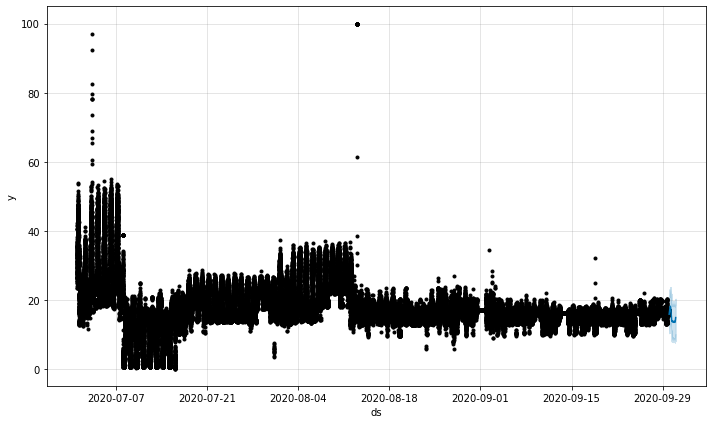

In [35]:
fig1 = model.plot(forecast)


In [37]:
import plotly.graph_objects as go

In [57]:
train_line = go.Scatter(x=train_data['ds'], y=train_data['y'], name="train_data", line=dict(color="royalblue", width=2))
test_line = go.Scatter(x=test_data['ds'], y=test_data['y'], name="test_data", line=dict(color="firebrick", width=2))
predict_line = go.Scatter(x=forecast['ds'], y=forecast['yhat'], name="predict", line=dict(color='rgb(0, 255, 0)', width=2))
upper_bound = go.Scatter(name='Upper Bound', x=forecast['ds'], y=forecast['yhat_upper'] , mode='lines',
        line=dict(width=0.2, color="rgb(255, 188, 0)"), fillcolor='rgba(68, 68, 68, 0.2)')

lower_bound = go.Scatter(name='Lower Bound', x=forecast['ds'], y=forecast['yhat_lower'] , mode='lines',
        line=dict(width=0.2, color="rgb(255, 0, 255)"), fillcolor='rgba(68, 68, 68, 0.2)', fill='tonexty')

fig = go.Figure(data=[train_line, test_line, predict_line, upper_bound, lower_bound])

fig.update_layout(autosize=False, width=1400, height=400)

fig.show()

In [58]:
import plotly as py
py.offline.plot(fig, filename="cluster_load.html")


'cluster_load.html'